# PROJECT 2: IMAGE QUILTING

In [1]:
!pip install numpy
!pip install matplotlib
!pip install opencv-python

import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import os
from random import random
import time

# modify to where you store your project data including utils.py
datadir = "C:\\Users\\parke\\Documents\\CS445\\roberte3_proj2\\" 

utilfn = datadir + "utils.py"
#!copy "$utilfn" .
samplesfn = datadir + "Data\\"
#!copy -r "$datafn" .
import utils


[notice] A new release of pip available: 22.3.1 -> 23.0.1
[notice] To update, run: C:\Users\parke\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip



[notice] A new release of pip available: 22.3.1 -> 23.0.1
[notice] To update, run: C:\Users\parke\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip

[notice] A new release of pip available: 22.3.1 -> 23.0.1
[notice] To update, run: C:\Users\parke\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


In [2]:
from utils import cut # default cut function for seam finding section

### Part I: Randomly Sampled Texture

In [3]:
def quilt_random(sample, out_size, patch_size):
    """
    Randomly samples square patches of size patchsize from sample in order to create an output image of size outsize.

    :param sample: numpy.ndarray   The image you read from sample directory
    :param out_size: int            The width of the square output image
    :param patch_size: int          The width of the square sample patch
    :return: numpy.ndarray
    """
    # Create an empty numpy.ndarray to hold the result
    res = np.zeros(shape=(out_size,out_size,3)).astype(float)
    # While the size of the result is smaller than the out_size param keep adding random patched
    i = 0
    while i < out_size:
        j = 0
        while j < out_size:
            # Get the dimensions (h and w) of the sample, .shape will also return 3 for the number of channels but we can disregard
            h, w, _ = sample.shape
            # Using these dimensions get random starting points for the patches from the sample and using those we can get and random patch
            hi = h - patch_size
            rand_hi = np.random.randint(hi)
            wj = w - patch_size
            rand_wj = np.random.randint(wj)
            patch = sample[rand_hi:rand_hi + patch_size, rand_wj:rand_wj + patch_size].copy()/255
            res[i:i+patch_size,j:j+patch_size] = patch.astype(float)
            j += patch_size
        i += patch_size
    
    return res
    

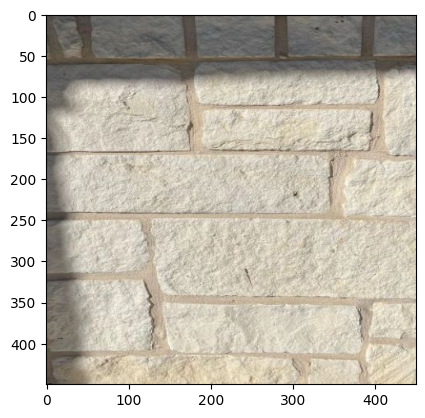

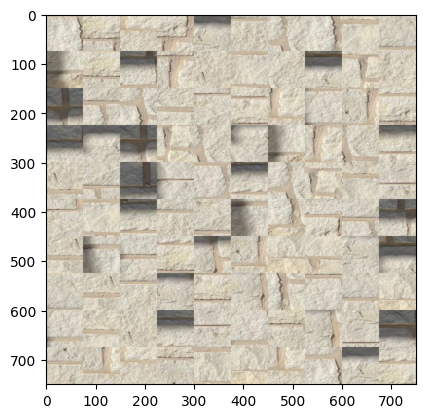

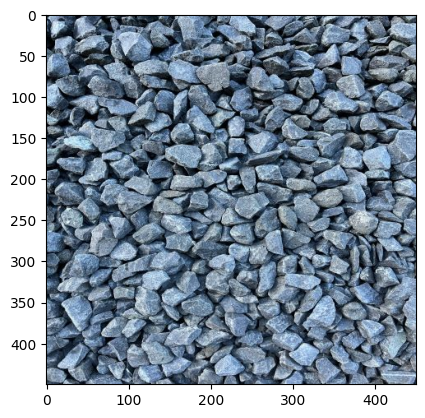

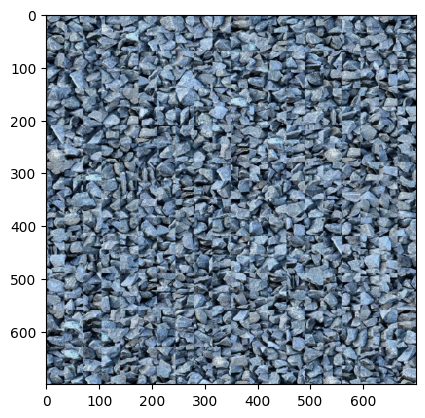

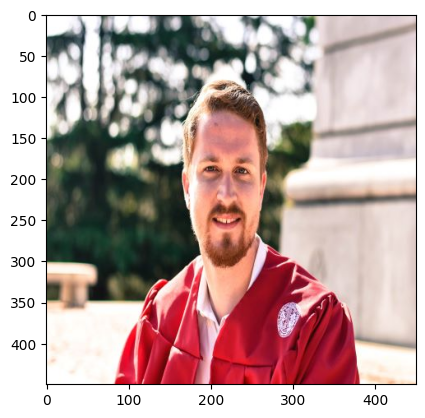

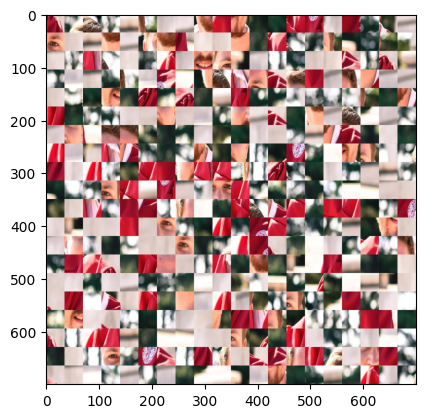

In [127]:
sample_img_fn = samplesfn + 'stone_wall_small.jpg'
sample_img = cv2.cvtColor(cv2.imread(sample_img_fn), cv2.COLOR_BGR2RGB)
plt.imshow(sample_img)
plt.show()

out_size = 750 
patch_size = 75 
res = quilt_random(sample_img, out_size, patch_size)
if res is not None:
    plt.imshow(res)
    plt.show()
    
sample_img_fn = samplesfn + 'gravel_small.jpg'
sample_img = cv2.cvtColor(cv2.imread(sample_img_fn), cv2.COLOR_BGR2RGB)
plt.imshow(sample_img)
plt.show()

out_size = 700 
patch_size = 35 
res = quilt_random(sample_img, out_size, patch_size)
if res is not None:
    plt.imshow(res)
    plt.show()
    
sample_img_fn = samplesfn + 'PE-3-small.jpg'
sample_img = cv2.cvtColor(cv2.imread(sample_img_fn), cv2.COLOR_BGR2RGB)
plt.imshow(sample_img)
plt.show()

out_size = 700 
patch_size = 35 
res = quilt_random(sample_img, out_size, patch_size)
if res is not None:
    plt.imshow(res)
    plt.show()

### Part II: Overlapping Patches 

In [5]:
def quilt_simple(sample, out_size, patch_size, overlap, tol):
    """
    Randomly samples square patches of size patchsize from sample in order to create an output image of size outsize.
    Feel free to add function parameters
    :param sample: numpy.ndarray
    :param out_size: int
    :param patch_size: int
    :param overlap: int
    :param tol: float
    :return: numpy.ndarray
    """
    # Create an empty numpy.ndarray to hold the result
    res = np.zeros(shape=(out_size, out_size, 3)).astype(float)

    # Variables to handle the overlaps and steps through the image
    half_patch = patch_size // 2
    step_size = patch_size - overlap
    number_of_patches = (out_size - patch_size + overlap) // step_size

    # Seed res with an initial patch
    res[:patch_size,:patch_size] = sample[:patch_size,:patch_size].copy()/255

    for y in range(number_of_patches):
        for x in range(number_of_patches):
            # Create base mask array
            mask = np.zeros(shape=(patch_size,patch_size,3)).astype(float)
            if y == 0 and x > 0:
                mask[:,:overlap,:] = 1.0
            elif y > 0 and x == 0:
                mask[:overlap,:,:] = 1.0
            elif y > 0 and x > 0:
                mask[:overlap,:overlap,:] = 1.0

            template = res[y*step_size:y*step_size+patch_size,x*step_size:x*step_size+patch_size]
            cost_image = ssd_patch(sample/255, template, mask)
            i, j = choose_sample(cost_image[half_patch:-half_patch,half_patch:-half_patch], tol)
            res[y*step_size:y*step_size+patch_size,x*step_size:x*step_size+patch_size] = sample[i:i+patch_size,j:j+patch_size]/255
    
    return res

def ssd_patch(sample, template, mask):
    ssd_cost = ((mask*template)**2).sum() + cv2.filter2D(sample ** 2, ddepth=-1, kernel=mask[:,:,0]).sum(axis=2)
    for channel in range(3):
        ssd_cost_channels = 2 * cv2.filter2D(sample[:,:,channel], ddepth=-1, kernel=mask[:,:,channel]*template[:,:,channel])
        ssd_cost -= ssd_cost_channels
    return ssd_cost

def choose_sample(cost_image, tol):
    sorted_image = np.argsort(cost_image, None)
    inds = np.unravel_index(sorted_image, cost_image.shape)
    rand_ind = (int)(random()*tol)
    y, x = inds[0][rand_ind], inds[1][rand_ind]
    return y, x

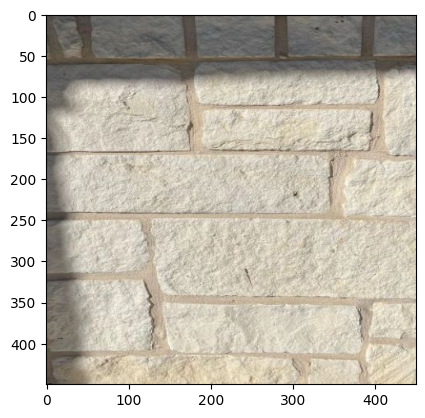

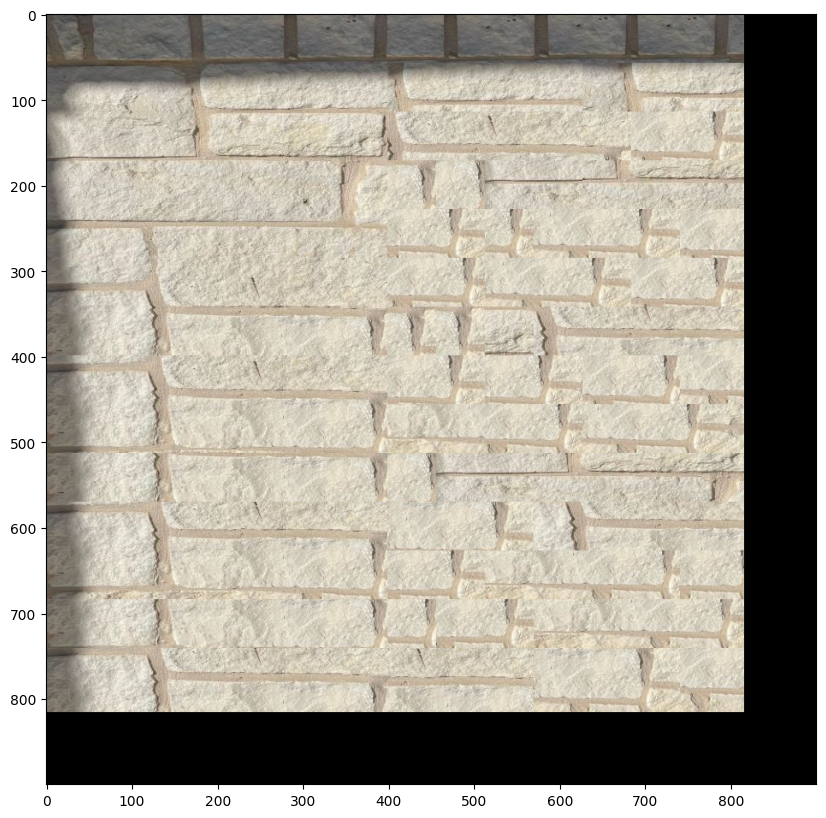

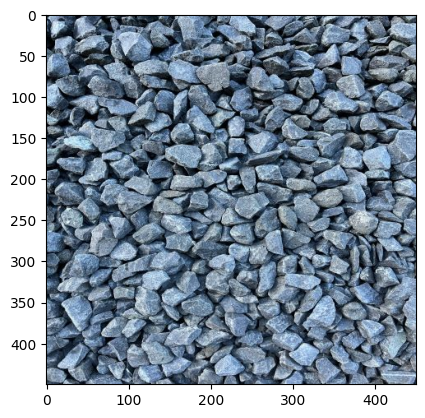

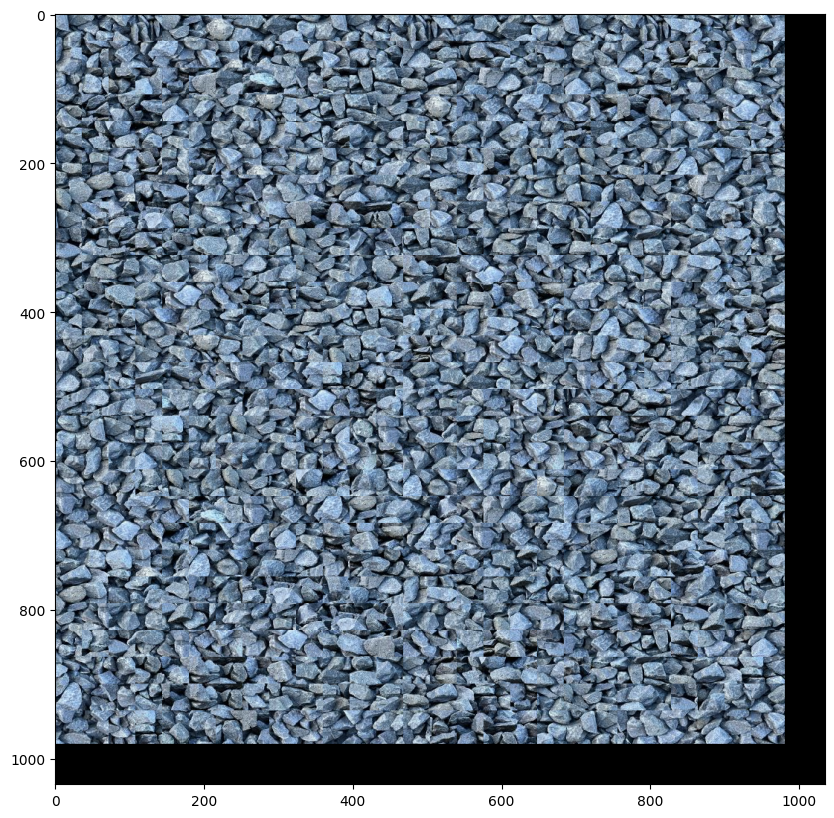

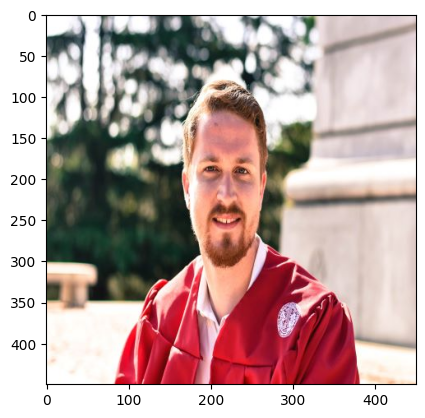

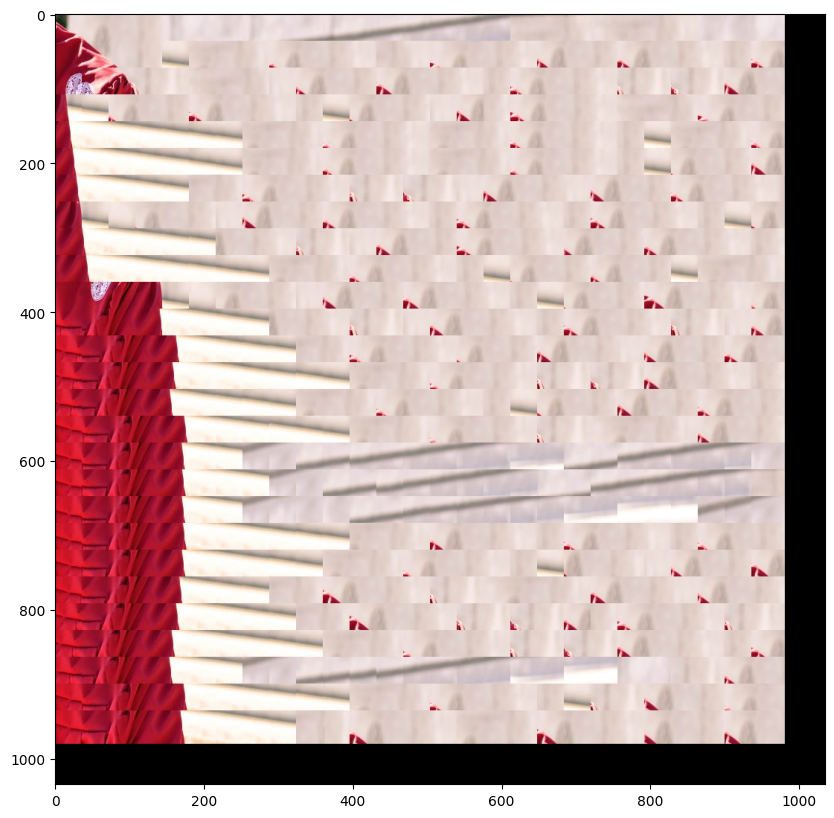

In [128]:
sample_img_fn_1 = samplesfn + 'stone_wall_small.jpg'
sample_img_1 = cv2.cvtColor(cv2.imread(sample_img_fn_1), cv2.COLOR_BGR2RGB)
plt.imshow(sample_img_1)
plt.show()

out_size = 900  # change these parameters as needed
patch_size = 75
overlap = 18
tol = 2
res = quilt_simple(sample_img_1, out_size, patch_size, overlap, tol) #feel free to change parameters to get best results
if res is not None:
    plt.figure(figsize=(10,10))
    plt.imshow(res)
    plt.show()
    
sample_img_fn_2 = samplesfn + 'gravel_small.jpg'
sample_img_2 = cv2.cvtColor(cv2.imread(sample_img_fn_2), cv2.COLOR_BGR2RGB)
plt.imshow(sample_img_2)
plt.show()

out_size = 1035  # change these parameters as needed
patch_size = 45
overlap = 9
tol = 7
res = quilt_simple(sample_img_2, out_size, patch_size, overlap, tol) #feel free to change parameters to get best results
if res is not None:
    plt.figure(figsize=(10,10))
    plt.imshow(res)
    plt.show()
    
sample_img_fn_2 = samplesfn + 'PE-3-small.jpg'
sample_img_2 = cv2.cvtColor(cv2.imread(sample_img_fn_2), cv2.COLOR_BGR2RGB)
plt.imshow(sample_img_2)
plt.show()

out_size = 1035  # change these parameters as needed
patch_size = 45
overlap = 9
tol = 7
res = quilt_simple(sample_img_2, out_size, patch_size, overlap, tol) #feel free to change parameters to get best results
if res is not None:
    plt.figure(figsize=(10,10))
    plt.imshow(res)
    plt.show()

### Part III: Seam Finding

In [7]:
# optional or use cut(err_patch) directly
def customized_cut(bndcost):
    pass

In [75]:
def quilt_cut(sample, out_size, patch_size, overlap, tol):
    """
    Samples square patches of size patchsize from sample using seam finding in order to create an output image of size outsize.
    Feel free to add function parameters
    :param sample: numpy.ndarray
    :param out_size: int
    :param patch_size: int
    :param overlap: int
    :param tol: float
    :return: numpy.ndarray
    """
    # Create an empty numpy.ndarray to hold the result
    res = np.zeros(shape=(out_size, out_size, 3)).astype(float)

    # Variables to handle the overlaps and steps through the image
    half_patch = patch_size // 2
    step_size = patch_size - overlap
    number_of_patches = (out_size - patch_size + overlap) // step_size

    # Seed res with an initial patch
    res[:patch_size,:patch_size] = sample[:patch_size,:patch_size].copy()/255

    for y in range(number_of_patches):
        for x in range(number_of_patches):
            # Create base mask array
            mask = np.zeros(shape=(patch_size,patch_size,3)).astype(float)
            if y == 0 and x > 0:
                mask[:,:overlap,:] = 1.0
            elif y > 0 and x == 0:
                mask[:overlap,:,:] = 1.0
            elif y > 0 and x > 0:
                mask[:overlap,:overlap,:] = 1.0

            template = res[y*step_size:y*step_size+patch_size,x*step_size:x*step_size+patch_size]
            cost_image = ssd_patch(sample/255, template, mask)
            i, j = choose_sample(cost_image[half_patch:-half_patch,half_patch:-half_patch], tol)
            to_seam = sample[i:i+patch_size,j:j+patch_size]/255
            
            # Based on its location, get the difference between the overlapping region, and get its squared diff over the 3 color channels
            # Once the cut is found and passed as a mask, all pixels left of cut come from res, to the right come from sample
            # The mask will let the to_seam patch through when the area is in the overlap portion and has a value greater than 0
            if y == 0 and x > 0:
                diff = res[y*step_size:y*step_size+patch_size,x*step_size:x*step_size+overlap] - to_seam[:patch_size,:overlap]
                ssd = diff[:,:,0]**2 + diff[:,:,1]**2 + diff[:,:,2]**2
                bnd_mask = cut(ssd.T).T
                for i in range(0, patch_size):
                        for j in range(patch_size):
                            if j < overlap and bnd_mask[i,j] == 0:
                                pass
                            res[y*step_size+i, x*step_size+j] = to_seam[i,j]
            elif y > 0 and x == 0:
                diff = res[y*step_size:y*step_size+overlap,x*step_size:x*step_size+patch_size] - to_seam[:overlap,:patch_size]
                ssd = diff[:,:,0]**2 + diff[:,:,1]**2 + diff[:,:,2]**2
                bnd_mask = cut(ssd)
                for i in range(0, patch_size):
                        for j in range(patch_size):
                            if i < overlap and bnd_mask[i,j] == 0:
                                pass
                            res[y*step_size+i, x*step_size+j] = to_seam[i,j]
            elif y > 0 and x > 0:
                diff_y = res[y*step_size:y*step_size+patch_size,x*step_size:x*step_size+overlap] - to_seam[:patch_size,:overlap]
                diff_x = res[y*step_size:y*step_size+overlap,x*step_size:x*step_size+patch_size] - to_seam[:overlap,:patch_size]
                ssd_y = diff_y[:,:,0]**2 + diff_y[:,:,1]**2 + diff_y[:,:,2]**2
                ssd_x = diff_x[:,:,0]**2 + diff_x[:,:,1]**2 + diff_x[:,:,2]**2
                bnd_mask_y = cut(ssd_y.T).T
                bnd_mask_x = cut(ssd_x)
                bnd_mask = np.zeros(shape=(patch_size,patch_size)).astype(int)
                bnd_mask[:,:overlap] = bnd_mask_y
                bnd_mask[:overlap,:] = bnd_mask[:overlap,:] & bnd_mask_x
                for i in range(patch_size):
                        for j in range(patch_size):
                            if bnd_mask[y,x] == 0:
                                pass
                            res[y*step_size+j, x*step_size+i] = to_seam[j,i]
                            
    return res
            

def ssd_patch(sample, template, mask):
    ssd_cost = ((mask*template)**2).sum() + cv2.filter2D(sample ** 2, ddepth=-1, kernel=mask[:,:,0]).sum(axis=2)
    for channel in range(3):
        ssd_cost_channels = 2 * cv2.filter2D(sample[:,:,channel], ddepth=-1, kernel=mask[:,:,channel]*template[:,:,channel])
        ssd_cost -= ssd_cost_channels
    return ssd_cost

def choose_sample(cost_image, tol):
    sorted_image = np.argsort(cost_image, None)
    inds = np.unravel_index(sorted_image, cost_image.shape)
    rand_ind = (int)(random()*tol)
    y, x = inds[0][rand_ind], inds[1][rand_ind]
    return y, x

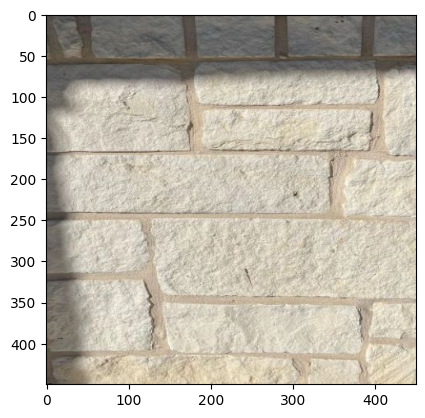

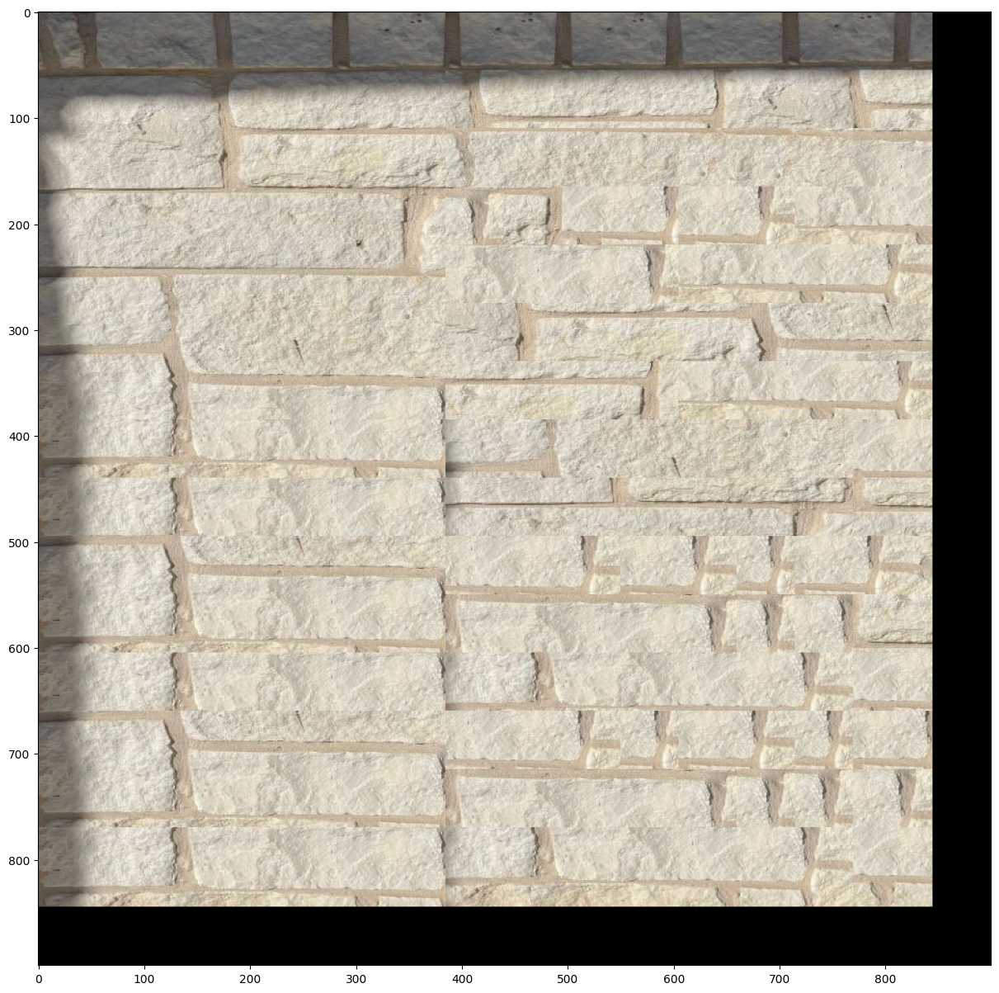

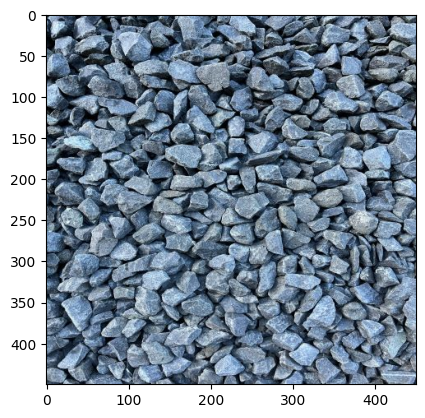

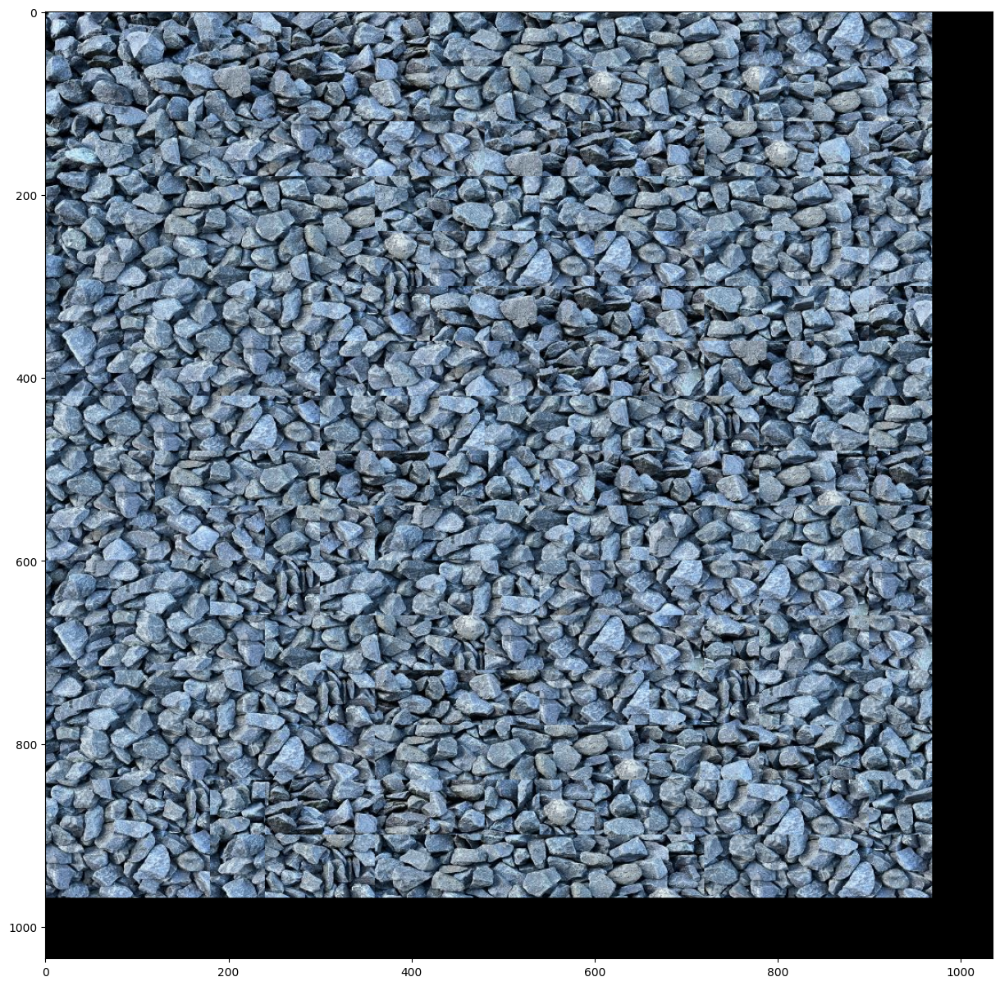

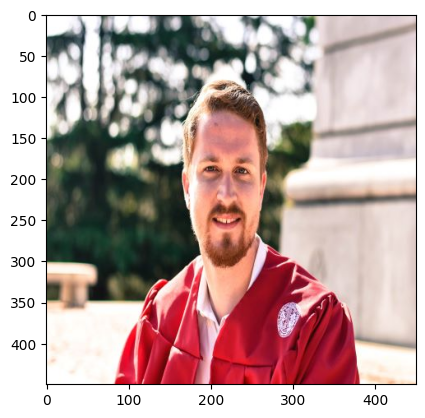

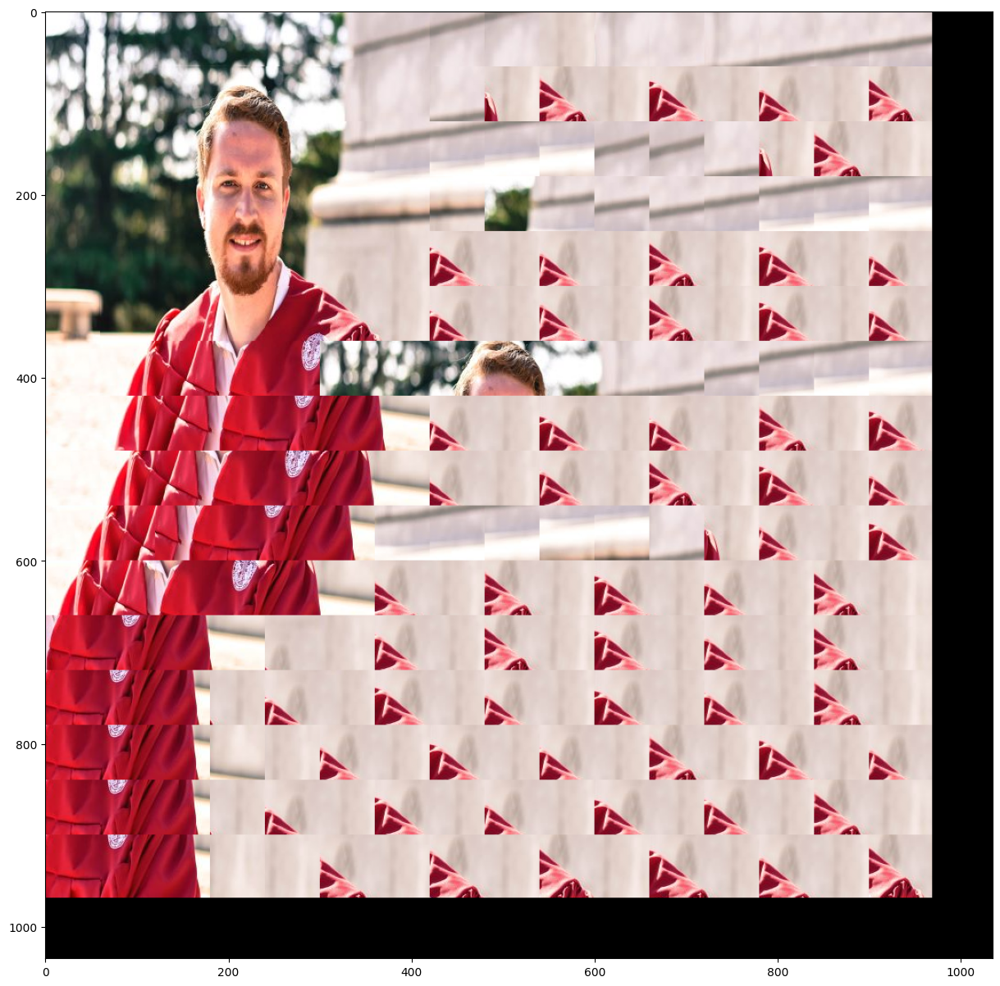

In [129]:
sample_img_fn_1 = samplesfn + 'stone_wall_small.jpg'
sample_img_1 = cv2.cvtColor(cv2.imread(sample_img_fn_1), cv2.COLOR_BGR2RGB)
plt.imshow(sample_img_1)
plt.show()

out_size = 900  # change these parameters as needed
patch_size = 75
overlap = 20
tol = 1
res = quilt_cut(sample_img_1, out_size, patch_size, overlap, tol)
if res is not None:
    plt.figure(figsize=(15,15))
    plt.imshow(res)
    plt.show()
    
sample_img_fn_2 = samplesfn + 'gravel_small.jpg'
sample_img_2 = cv2.cvtColor(cv2.imread(sample_img_fn_2), cv2.COLOR_BGR2RGB)
plt.imshow(sample_img_2)
plt.show()

out_size = 1035  # change these parameters as needed
patch_size = 69
overlap = 9
tol = 2
res = quilt_cut(sample_img_2, out_size, patch_size, overlap, tol)
if res is not None:
    plt.figure(figsize=(15,15))
    plt.imshow(res)
    plt.show()
    
sample_img_fn_2 = samplesfn + 'PE-3-small.jpg'
sample_img_2 = cv2.cvtColor(cv2.imread(sample_img_fn_2), cv2.COLOR_BGR2RGB)
plt.imshow(sample_img_2)
plt.show()

out_size = 1035  # change these parameters as needed
patch_size = 69
overlap = 9
tol = 2
res = quilt_cut(sample_img_2, out_size, patch_size, overlap, tol)
if res is not None:
    plt.figure(figsize=(15,15))
    plt.imshow(res)
    plt.show()

### Part IV: Texture Transfer

In [132]:
def texture_transfer(sample, patch_size, overlap, tol, guidance_im, alpha):
    """
    Samples square patches of size patchsize from sample using seam finding in order to create an output 
    image of size outsize.
    Feel free to modify function parameters
    :param sample: numpy.ndarray
    :param patch_size: int
    :param overlap: int
    :param tol: float
    :param guidance_im: target overall appearance for the output
    :param alpha: float 0-1 for strength of target
    :return: numpy.ndarray
    """
    h, w, _ = guidance_im.shape
    # Create an empty numpy.ndarray to hold the result
    res = np.zeros(shape=(h, w, 3)).astype(np.uint8)

    # Variables to handle the overlaps and steps through the image
    half_patch = patch_size // 2
    step_size = patch_size - overlap
    number_of_patches = (out_size - patch_size + overlap) // step_size

    # Seed res with an initial patch
    res[:patch_size,:patch_size] = sample[:patch_size,:patch_size]
        
    for y in range(0, h - patch_size + 1, step_size):
        for x in range(0, w - patch_size + 1, step_size):
            mask = np.zeros(shape=(patch_size,patch_size,3))
            g_mask = np.zeros(shape=(patch_size,patch_size,3))
            mask[:overlap,:,:] = 1
            g_mask[:,:,:] = 1
            if y == 0 and x > 0:
                mask[:,:overlap,:] = 1
            elif y > 0 and x > 0:
                mask[:overlap,:overlap,:] = 1

            template = res[y:y+patch_size, x:x+patch_size]
            ssd_overlap  = ssd_patch(sample, template, mask)
            guide_template = guidance_im[y:y+patch_size, x:x+patch_size]
            ssd_transfer = ssd_patch(sample, guide_template, g_mask)
            cost_img = alpha * ssd_overlap + (1 - alpha) * ssd_transfer
            a, b = choose_sample(cost_img[half_patch:-half_patch, half_patch:-half_patch], tol)
            t_patch = sample[a:a+patch_size, b:b+patch_size]

            if y == 0 and x > 0:
                diff = res[y:y+patch_size, x:x+overlap] - t_patch[:patch_size,:overlap]
                ssd = diff[:,:,0]**2 + diff[:,:,1]**2 + diff[:,:,2]**2

                mask = cut(ssd.T).T
                for i in range(0, patch_size):
                    for j in range(0, patch_size):
                        if j < overlap and mask[i,j] == 0:
                            pass
                        res[y+i, x+j] = t_patch[i,j]

            elif y > 0 and x == 0:
                diff = res[y:y+overlap, x:x+patch_size] - t_patch[:overlap,:patch_size]
                ssd = diff[:,:,0]**2 + diff[:,:,1]**2 + diff[:,:,2]**2

                mask = cut(ssd)
                for i in range(0, patch_size):
                    for j in range(0, patch_size):
                        if i < overlap and mask[i,j] == 0:
                            pass
                        res[y+i, x+j] = t_patch[i,j]

            else:
                diff_y = res[y:y+patch_size, x:x+overlap] - t_patch[:patch_size,:overlap]
                ssd_y = diff_y[:,:,0]**2 + diff_y[:,:,1]**2 + diff_y[:,:,2]**2
                mask_y = cut(ssd_y.T).T
                diff_x = res[y:y+overlap, x:x+patch_size] - t_patch[:overlap,:patch_size]
                ssd_x = diff_x[:,:,0]**2 + diff_x[:,:,1]**2 + diff_x[:,:,2]**2
                mask_x = cut(ssd_x)
                for i in range(0, patch_size):
                    for j in range(0, patch_size):
                        if i < overlap and mask_x[i,j] == 0:
                            pass
                        if j < overlap and mask_y[i,j] == 0:
                            pass
                        res[y+j, x+i] = t_patch[j, i]
                    
    return res
    


def ssd_patch(sample, template, mask):
    sq = sample.astype(np.float64)**2
    ssd_cost = cv2.filter2D(sq, ddepth=-1, kernel=mask[:,:,0]).sum(axis=2)
    ssd_cost += ((mask*template)**2).sum()
    for c in range(3):
        s2 = cv2.filter2D(sample[:,:,c].astype(np.float64), ddepth=-1, kernel=mask[:,:,c]*template[:,:,c])
        ssd_cost -= 2 * s2
    return ssd_cost




def choose_sample(cost_image, tol):
    sorted_image = np.argsort(cost_image, None)
    inds = np.unravel_index(sorted_image, cost_image.shape)
    rand_ind = (int)(random()*tol)
    i, j = inds[0][rand_ind], inds[1][rand_ind]
    return i, j

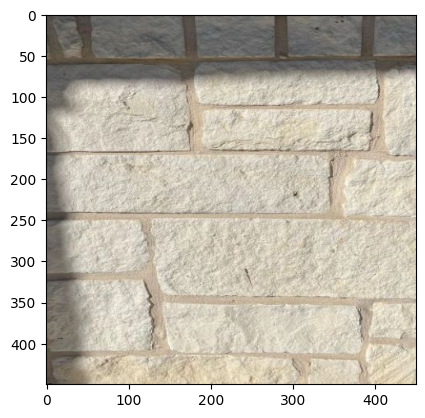

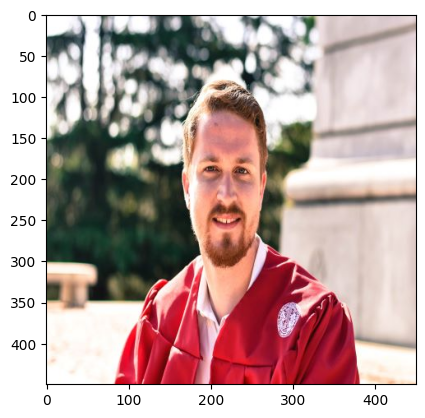

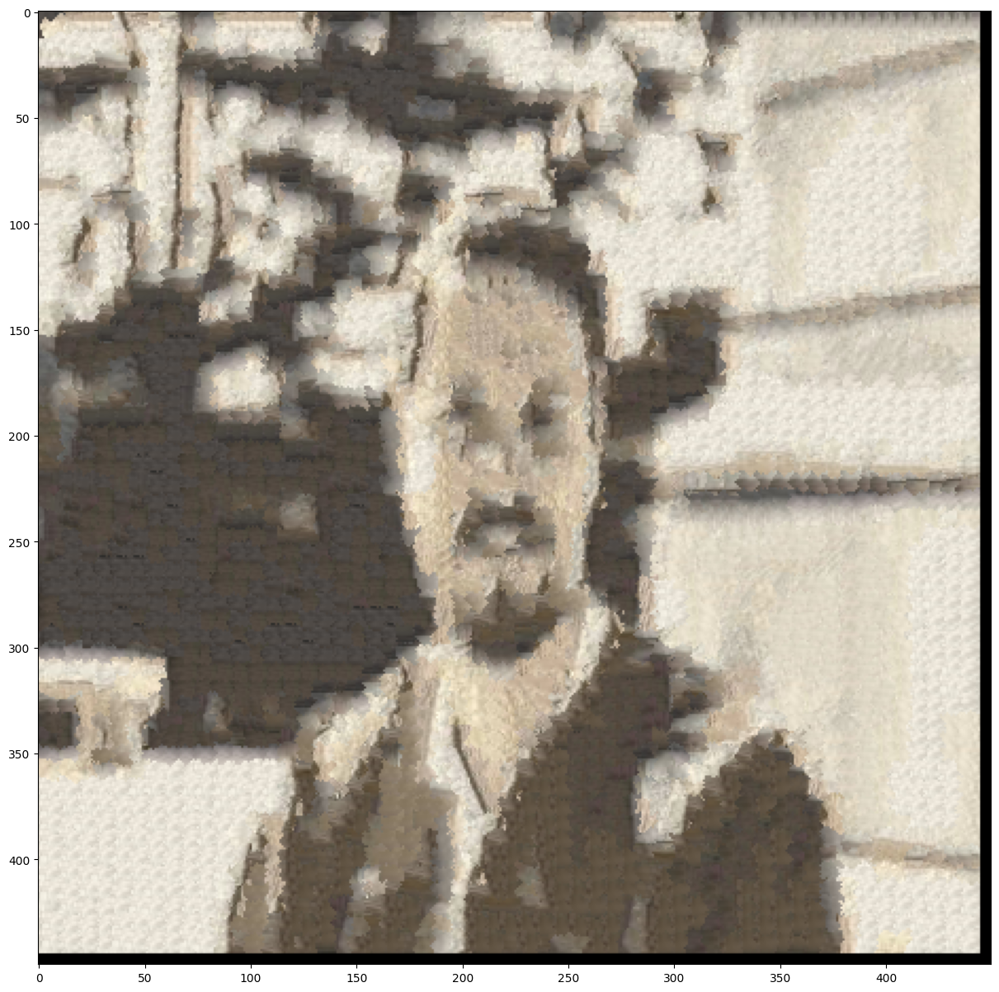

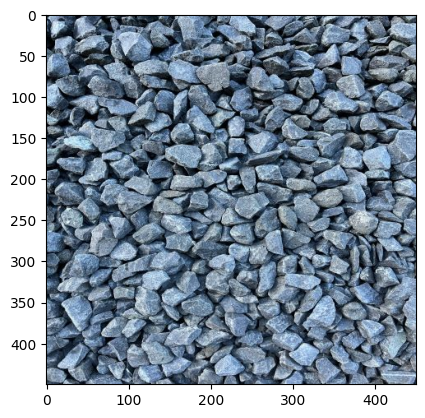

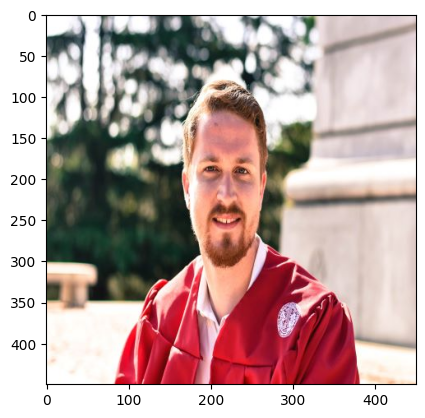

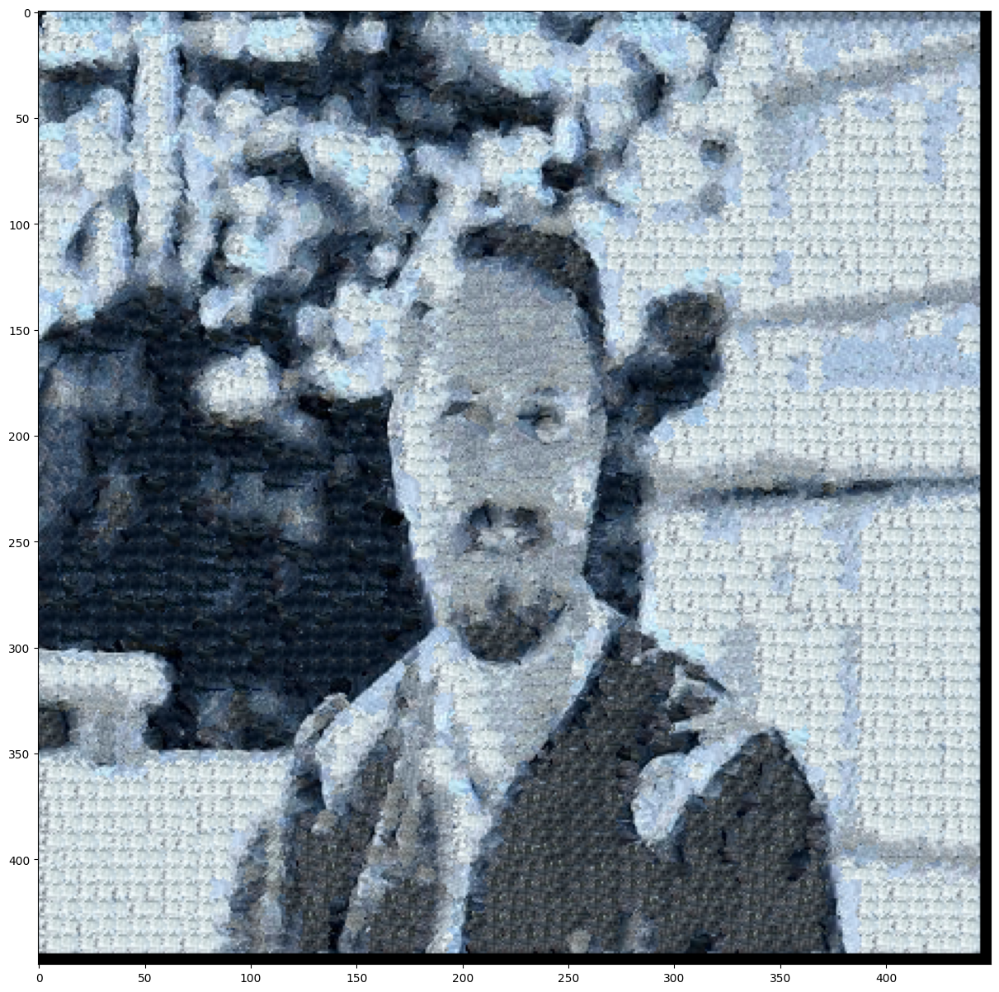

In [133]:
# load/process appropriate input texture and guidance images
texture_img = samplesfn + 'stone_wall_small.jpg'
sample_texture = cv2.cvtColor(cv2.imread(texture_img), cv2.COLOR_BGR2RGB)
plt.imshow(sample_texture)
plt.show()
guidance_img = samplesfn + 'PE-3-small.jpg'
sample_guide = cv2.cvtColor(cv2.imread(guidance_img), cv2.COLOR_BGR2RGB)
plt.imshow(sample_guide)
plt.show()

patch_size = 13
overlap = 5
tol = 3
alpha = 0.5
res = texture_transfer(sample_texture, patch_size, overlap, tol, sample_guide, alpha)

plt.figure(figsize=(15,15))
plt.imshow(res)
plt.show()

# load/process appropriate input texture and guidance images
texture_img = samplesfn + 'gravel_small.jpg'
sample_texture = cv2.cvtColor(cv2.imread(texture_img), cv2.COLOR_BGR2RGB)
plt.imshow(sample_texture)
plt.show()
guidance_img = samplesfn + 'PE-3-small.jpg'
sample_guide = cv2.cvtColor(cv2.imread(guidance_img), cv2.COLOR_BGR2RGB)
plt.imshow(sample_guide)
plt.show()

patch_size = 13
overlap = 5
tol = 3
alpha = 0.5
res = texture_transfer(sample_texture, patch_size, overlap, tol, sample_guide, alpha)

plt.figure(figsize=(15,15))
plt.imshow(res)
plt.show()